<a href="https://colab.research.google.com/github/Utpal-Mishra/Omdena-Malaysia-2021-Climate-Risk-Prediction-Part1/blob/main/OmdenaMalaysia2021ClimateRiskPredictionPart1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### **IMPORT DRIVE**

In [1]:
from google.colab import drive
drive.mount('/content/drive')

print("Drive Mounted!!!")

Mounted at /content/drive
Drive Mounted!!!


### **IMPORT LIBRARIES**

In [2]:
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go

print("Libraries Imported!!!")

Libraries Imported!!!


### **IMPORT DATA**

In [4]:
path = "/content/drive/MyDrive/Omdena/Malaysia 2021/Task 1 Climate Risk Prediction/14StationsData.csv"

data = pd.read_csv(path)
print("Data Shape: ", data.shape)
data.head()

Data Shape:  (194296, 10)


,STATION,NAME,LATITUDE,LONGITUDE,ELEVATION,DATE,PRCP,TAVG,TMAX,TMIN
0,MYM00096471,"KOTA KINABALU INTERNATIONAL, MY",5.937,116.051,3.0,1981-01-01,7.9,26.8,31.0,23.0
1,MYM00096471,"KOTA KINABALU INTERNATIONAL, MY",5.937,116.051,3.0,1981-01-02,0.0,26.5,31.0,24.0
2,MYM00096471,"KOTA KINABALU INTERNATIONAL, MY",5.937,116.051,3.0,1981-01-03,31.0,25.9,30.0,24.0
3,MYM00096471,"KOTA KINABALU INTERNATIONAL, MY",5.937,116.051,3.0,1981-01-04,14.0,26.6,29.0,23.0
4,MYM00096471,"KOTA KINABALU INTERNATIONAL, MY",5.937,116.051,3.0,1981-01-05,0.5,27.1,31.0,24.0


## **EXPLORATORY DATA ANALYSIS**

### **Checking Missing Values**

In [5]:
data.isna().sum()

STATION          0
NAME             0
LATITUDE         0
LONGITUDE        0
ELEVATION        0
DATE             0
PRCP         30373
TAVG          2893
TMAX         71659
TMIN         78357
dtype: int64

### **Replacing Missing Values with Column Means**

In [6]:
data = data.fillna(data.mean())
print("Empty Values Left: ", data.isna().sum().sum())

Empty Values Left:  0


### **Frequency of Station Names in Malaysia**

In [7]:
data.NAME.value_counts()

KUCHING, MY                                 14797
SANDAKAN, MY                                14792
LABUAN, MY                                  14791
SITIAWAN, MY                                14788
PENANG INTERNATIONAL, MY                    14756
KUANTAN, MY                                 14755
MALACCA, MY                                 14696
SULTAN ISMAIL PETRA, MY                     14686
SIBU, MY                                    14639
KOTA KINABALU INTERNATIONAL, MY             14607
MIRI, MY                                    14592
SULTAN ABDUL AZIZ SHAH INTERNATIONAL, MY    13952
TAWAU, MY                                   12410
KUALA LUMPUR INTERNATIONAL, MY               6035
Name: NAME, dtype: int64

### **DATA ANALYSIS and INTERPRETATION**

In [8]:
import datetime

data["YEAR"] = data.DATE.apply(lambda x: datetime.datetime.strptime(x, "%Y-%m-%d").year)
data["MONTH"] = data.DATE.apply(lambda x: datetime.datetime.strptime(x, "%Y-%m-%d").month)
cleandata = data.groupby(['NAME', 'YEAR'], as_index = False).first()
print("Data Dimensions: ", cleandata.shape)
cleandata.tail()

Data Dimensions:  (543, 12)


,NAME,YEAR,STATION,LATITUDE,LONGITUDE,ELEVATION,DATE,PRCP,TAVG,TMAX,TMIN,MONTH
538,"TAWAU, MY",2017,MYM00096481,4.313,118.122,17.4,2017-01-01,5.300000,25.6,30.900000,23.737928,1
539,"TAWAU, MY",2018,MYM00096481,4.313,118.122,17.4,2018-01-01,8.021009,27.0,31.793158,22.900000,1
540,"TAWAU, MY",2019,MYM00096481,4.313,118.122,17.4,2019-01-01,4.100000,27.2,31.793158,23.500000,1
541,"TAWAU, MY",2020,MYM00096481,4.313,118.122,17.4,2020-01-01,8.021009,28.0,31.793158,23.737928,1
542,"TAWAU, MY",2021,MYM00096481,4.313,118.122,17.4,2021-01-01,4.300000,25.4,31.793158,23.737928,1


In [9]:
fig = go.Figure()
fig = px.bar(cleandata, x='NAME', y="TAVG", animation_frame = "DATE", color = "TAVG", text='TAVG')
# fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)', marker_line_width=1.5, opacity=0.6)
fig.update_xaxes(title_text = "State Names in Malaysia", linewidth=1, linecolor='black', mirror=True)
fig.update_yaxes(title_text = "Temperature", showline=True, linewidth=1, linecolor='black', mirror=True)
# fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.update_layout(height=600, width=1200, title_text="Temperature in Malaysia", barmode='group', xaxis_tickangle=-45, yaxis_range=[0,120]) 
fig.show()

In [10]:
# fig = go.Figure()
# fig = px.bar(cleandata, x='NAME', y="PRCP", animation_frame = "DATE", color = "PRCP", text='PRCP')
# # fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)', marker_line_width=1.5, opacity=0.6)
# fig.update_xaxes(title_text = "State Names in Malaysia", linewidth=1, linecolor='black', mirror=True)
# fig.update_yaxes(title_text = "Precipitation", showline=True, linewidth=1, linecolor='black', mirror=True)
# # fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
# fig.update_layout(height=600, width=1200, title_text="Precipitation in Malaysia", barmode='group', xaxis_tickangle=-45, yaxis_range=[0,120]) 
# fig.show()

fig = go.Figure()
fig = px.scatter(cleandata, x="NAME", y="PRCP", animation_frame="DATE",
           size="PRCP", color="NAME", hover_name="NAME",
           log_x=False, range_y=[0, 120])
fig.update_xaxes(title_text = "State Names in Malaysia", linewidth=1, linecolor='black', mirror=True)
fig.update_yaxes(title_text = "Precipitation", showline=True, linewidth=1, linecolor='black', mirror=True)
fig.update_layout(height=600, width=1500, title_text="Precipitation in Malaysia", barmode='group', xaxis_tickangle=-45, yaxis_range=[0,120]) 
fig.show()

## **PLOTS**

### **Plotting Functions**

In [11]:
def temperature(df):
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=df.DATE, y=df.TAVG, mode='lines', name='tavg lines'))
  fig.add_trace(go.Scatter(x=df.DATE, y=df.TMIN, mode='lines', name='tmin lines'))
  fig.add_trace(go.Scatter(x=df.DATE, y=df.TMAX, mode='lines', name='tmax lines'))
  fig.update_xaxes(title_text = "DATE", rangeslider_visible=True, showline=True, linewidth=2, linecolor='black', mirror=True)
  fig.update_yaxes(title_text = "TEMPERATURE", showline=True, linewidth=2, linecolor='black', mirror=True)
  fig.update_layout(height=450, width=1000, title_text="Observation of Tmin, Tavg, Tmax in Different Parts of Malaysia") 
  fig.show()


def precipitation(df):
  fig = go.Figure()
  fig.add_trace(go.Scatter(x=df.DATE, y=df.PRCP, mode='lines', name='tavg lines'))
  fig.update_xaxes(title_text = "DATE", rangeslider_visible=True, showline=True, linewidth=2, linecolor='black', mirror=True)
  fig.update_yaxes(title_text = "PRECIPITATION", showline=True, linewidth=2, linecolor='black', mirror=True)
  fig.update_layout(height=450, width=1000, title_text="Precipitation in Parts of Malaysia") 
  fig.show()



def map(df):
  fig = px.scatter_geo(df, 
                     lat='LATITUDE', 
                     lon='LONGITUDE', 
                     size='PRCP', 
                     animation_frame="DATE", 
                     title='PRECIPITATION in MALAYSIA', 
                     projection = "orthographic", 
                     width = 1000,
                     height = 500, 
                     color = "NAME")
  fig.update(layout_coloraxis_showscale=False)
  fig.show()

In [12]:
map(cleandata)

### **KUCHING, MY** 

**TEMPERATURE ANALYSIS**

In [13]:
df = data[data.NAME == "KUCHING, MY"]

temperature(df)

**PRECIPITATION**

In [14]:
precipitation(df)

In [15]:
map(df.head(100))

### **SANDAKAN, MY**

**TEMPERATURE ANALYSIS**

In [16]:
df = data[data.NAME == "SANDAKAN, MY"]

temperature(df)

**PRECIPITATION**

In [17]:
precipitation(df)

In [18]:
map(df.head(100))

### **LABUAN, MY**

**TEMPERATURE ANALYSIS**

In [19]:
df = data[data.NAME == "LABUAN, MY"]

temperature(df)

**PRECIPITATION**

In [20]:
precipitation(df)

In [21]:
map(df.head(100))

### **SITIAWAN, MY**

**TEMPERATURE ANALYSIS**

In [22]:
df = data[data.NAME == "SITIAWAN, MY"]

temperature(df)

**PRECIPITATION**

In [23]:
precipitation(df)

In [24]:
map(df.head(100))

### **PENANG INTERNATIONAL, MY**

**TEMPERATURE ANALYSIS**

In [25]:
df = data[data.NAME == "PENANG INTERNATIONAL, MY"]

temperature(df)

**PRECIPITATION**

In [26]:
precipitation(df)

In [27]:
map(df.head(100))

### **KUANTAN, MY**

**TEMPERATURE ANALYSIS**

In [28]:
df = data[data.NAME == "KUANTAN, MY"]

temperature(df)

**PRECIPITATION**

In [29]:
precipitation(df)

In [30]:
map(df.head(100))

### **MALACCA, MY**

**TEMPERATURE ANALYSIS**

In [31]:
df = data[data.NAME == "MALACCA, MY"]

temperature(df)

**PRECIPITATION**

In [32]:
precipitation(df)

In [33]:
map(df.head(100))

### **SULTAN ISMAIL PETRA, MY** 

**TEMPERATURE ANALYSIS**

In [34]:
df = data[data.NAME == "SULTAN ISMAIL PETRA, MY"]

temperature(df)

**PRECIPITATION**

In [35]:
precipitation(df)

In [36]:
map(df.head(100))

### **SIBU, MY** 

**TEMPERATURE ANALYSIS**

In [37]:
df = data[data.NAME == "SIBU, MY"]

temperature(df)

**PRECIPITATION**

In [38]:
precipitation(df)

In [39]:
map(df.head(100))

### **KOTA KINABALU INTERNATIONAL, MY**

**TEMPERATURE ANALYSIS**

In [40]:
df = data[data.NAME == "KOTA KINABALU INTERNATIONAL, MY"]

temperature(df)

**PRECIPITATION**

In [41]:
precipitation(df)

In [42]:
map(df.head(100))

### **MIRI, MY**

**TEMPERATURE ANALYSIS**

In [43]:
df = data[data.NAME == "MIRI, MY"]

temperature(df)

**PRECIPITATION**

In [44]:
precipitation(df)

In [45]:
map(df.head(100))

### **SULTAN ABDUL AZIZ SHAH INTERNATIONAL, MY**

**TEMPERATURE ANALYSIS**

In [46]:
df = data[data.NAME == "SULTAN ABDUL AZIZ SHAH INTERNATIONAL, MY"]

temperature(df)

**PRECIPITATION**

In [47]:
precipitation(df)

In [48]:
map(df.head(100))

### **TAWAU, MY**

**TEMPERATURE ANALYSIS**

In [49]:
df = data[data.NAME == "TAWAU, MY"]

temperature(df)

**PRECIPITATION**

In [50]:
precipitation(df)

In [51]:
map(df.head(100))

### **KUALA LUMPUR INTERNATIONAL, MY**

**TEMPERATURE ANALYSIS**

In [52]:
df = data[data.NAME == "KUALA LUMPUR INTERNATIONAL, MY"]

temperature(df)

**PRECIPITATION**

In [53]:
precipitation(df)

In [54]:
map(df.head(100))

## **MAP**

In [55]:
import requests # library to handle requests
import pandas as pd # library for data analsysis
import numpy as np # library to handle data in a vectorized manner
import random # library for random number generation

#!conda install -c conda-forge geopy --yes 
from geopy.geocoders import Nominatim # module to convert an address into latitude and longitude values

# libraries for displaying images
from IPython.display import Image 
from IPython.core.display import HTML 
    
# tranforming json file into a pandas dataframe library
#from pandas.io.json import json_normalize
from pandas import json_normalize

#!conda install -c conda-forge folium=0.5.0 --yes
import folium # plotting library

print('Folium installed')
print('Libraries imported.')

Folium installed
Libraries imported.


In [56]:
import random # library for random number generation
import numpy as np # library for vectorized computation
import pandas as pd # library to process data as dataframes

import matplotlib.pyplot as plt # plotting library
# backend for rendering plots within the browser
%matplotlib inline 

from sklearn.cluster import KMeans 
from sklearn.datasets.samples_generator import make_blobs

print('Libraries imported.')

Libraries imported.


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning:

The sklearn.datasets.samples_generator module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.datasets. Anything that cannot be imported from sklearn.datasets is now part of the private API.



In [57]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

#!conda install -c conda-forge geopy --yes # uncomment this line if you haven't completed the Foursquare API lab
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
#from pandas.io.json import json_normalize
from pandas import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

#!conda install -c conda-forge folium=0.5.0 --yes # uncomment this line if you haven't completed the Foursquare API lab
import folium # map rendering library

print('Libraries imported.')

Libraries imported.


In [58]:
#!pip install pandas==1.0.3
#import pandas as pd

In [59]:
address = 'Malaysia'

geolocator = Nominatim(user_agent="four_square")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of MALAYSIA are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of MALAYSIA are 4.5693754, 102.2656823.


In [60]:
import folium
Map = folium.Map(location = [latitude, longitude], zoom_start = 6, tiles = 'Stamen Terrain')

Marker = folium.map.FeatureGroup()

Marker.add_child(folium.CircleMarker([latitude, longitude], 
                                             radius = 5, 
                                             color = 'red', 
                                             fill_color = 'Red'))
Map.add_child(Marker)
folium.Marker([latitude, longitude], popup = 'Malaysia').add_to(Map)
Map

In [61]:
# create map of Malaysia using latitude and longitude values
Map = folium.Map(location=[latitude, longitude], zoom_start=6)

# add markers to map
for lat, lng, reg in zip(cleandata.LATITUDE, cleandata.LONGITUDE, cleandata.NAME):
    label = '{}, Ireland'.format(reg)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(Map)  
    
Map

In [62]:
# instantiate a feature group for the incidents in the dataframe
incidents = folium.map.FeatureGroup()

# loop through the 100 crimes and add each to the incidents feature group
for lat, lng, in zip(cleandata.LATITUDE, cleandata.LONGITUDE):
    incidents.add_child(
        folium.CircleMarker(
            [lat, lng],
            radius=5, # define how big you want the circle markers to be
            color='yellow',
            fill=True,
            fill_color='blue',
            fill_opacity=0.6
        )
    )

# add pop-up text to each marker on the map
latitudes = list(cleandata.LATITUDE)
longitudes = list(cleandata.LONGITUDE)
labels = list(cleandata.NAME)

for lat, lng, label in zip(latitudes, longitudes, labels):
    folium.Marker([lat, lng], popup=label).add_to(Map)    
    
# add incidents to map
Map.add_child(incidents)

# **FORECASTING**

## **ARIMA MODEL: Forecasting Precipitation**

### Time Series Plot

In [315]:
train = cleandata[:int(cleandata.shape[0]*0.80)][["DATE", "PRCP"]]
test = cleandata[int(cleandata.shape[0]*0.80):][["DATE", "PRCP"]]

train.set_index(['DATE'])
test.set_index(['DATE'])

print("Training Data: ", train.shape, "Testing Data: ", test.shape)

Training Data:  (434, 2) Testing Data:  (109, 2)


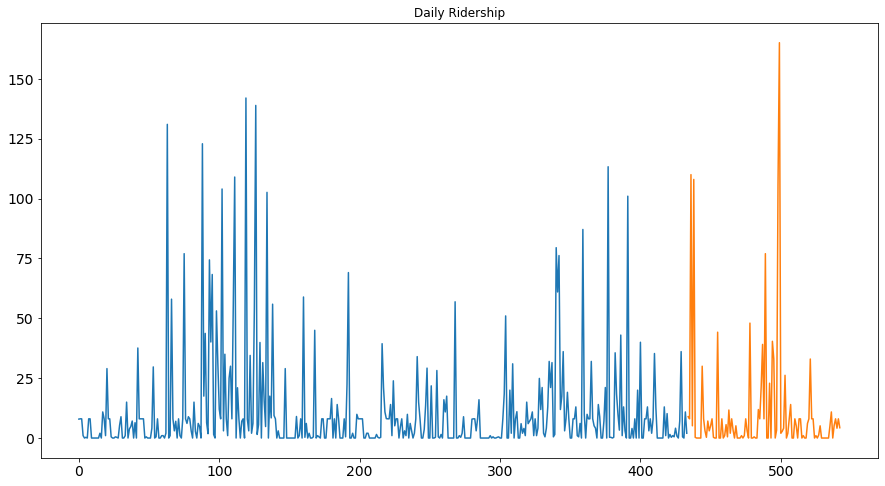

In [316]:
train.PRCP.plot(figsize=(15,8), title= 'Daily Ridership', fontsize=14)
test.PRCP.plot(figsize=(15,8), title= 'Daily Ridership', fontsize=14)
plt.show()

### ARIMA Forecasting

In [277]:
# from statsmodels.tsa.arima_model import ARIMA

# model = ARIMA(np.asarray(train), order = (5, 1, 0))
# model_fit = model.fit(disp = -1)

# # summary of fit model
# print(model_fit.summary())

# # line plot of residuals
# residuals = DataFrame(model_fit.resid)
# residuals.plot()
# plt.show()

# print("\n")
# # density plot of residuals
# residuals.plot(kind='kde')
# plt.show()

# # summary stats of residuals
# print(residuals.describe())

# rms_a = sqrt(mean_squared_error(test[y_hat_avg.isnull().sum().sum():].PRCP, y_hat_avg.dropna()["SARIMA"]))
# print("RMS Value: ", rms_a)

In [278]:
forecast = cleandata[['DATE', 'PRCP']].iloc[:41]
forecast.set_index('DATE',inplace=True)
forecast

,PRCP
DATE,
1981-01-01,7.900000
1982-01-01,8.021009
1983-01-01,8.021009
1984-01-01,1.000000
1985-01-01,0.000000
1986-01-01,0.300000
1987-01-01,0.000000
1988-01-01,8.021009
1989-01-01,8.021009


In [279]:
forecast.describe()

,PRCP
count,41.000000
mean,3.947489
std,5.706392
min,0.000000
25%,0.000000
50%,1.000000
75%,8.021009
max,29.000000


In [280]:
import plotly.express as px

fig = go.Figure()
fig.add_trace(go.Scatter(x = forecast.index, y = forecast.PRCP, name = "Precipitation Record", line=dict(color='purple', width=4, dash = "dot")))
fig.update_xaxes(title_text = "YEAR", rangeslider_visible=True, showline=True, linewidth=2, linecolor='black', mirror=True)
fig.update_yaxes(title_text = "PRECIPIATION", showline=True, linewidth=2, linecolor='black', mirror=True)
fig.update_layout(height=500, width=1000, title='Malaysia Precipitation Record')
fig.show()

In [281]:
### Testing For Stationarity
from statsmodels.tsa.stattools import adfuller

test_result = adfuller(forecast.PRCP)

#Ho: It is non stationary
#H1: It is stationary
def adfuller_test(prcp):
    result = adfuller(prcp)
    labels = ['ADF Test Statistic','p-value','#Lags Used','Number of Observations Used']
    for value, label in zip(result, labels):
        print(label+' : '+str(value) )
    if result[1] <= 0.05:
        print("Strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data has no unit root and is stationary")
    else:
        print("Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary ")
      
adfuller_test(forecast.PRCP)

ADF Test Statistic : -5.544446713739431
p-value : 1.673137791261456e-06
#Lags Used : 0
Number of Observations Used : 40
Strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data has no unit root and is stationary


In [282]:
# forecast['PRCP First Difference'] = forecast['PRCP'] - forecast['PRCP'].shift(1)
# forecast['PRCP'].shift(1)

In [283]:
# forecast['Seasonal First Difference'] = forecast['PRCP'] - forecast['PRCP'].shift(12)
# forecast.head(10)

In [284]:
# ## Again test dickey fuller test
# adfuller_test(forecast['Seasonal First Difference'].dropna())

In [285]:
# fig = px.line(forecast, x = forecast.index, y = forecast['Seasonal First Difference'])
# fig.add_trace(go.Scatter(x = forecast.index, y = forecast['Seasonal First Difference'], name = "Seasonal First Difference Precipitation Record", line=dict(color='firebrick', width=4)))
# fig.update_xaxes(title_text = "YEAR", rangeslider_visible=True, showline=True, linewidth=2, linecolor='black', mirror=True)
# fig.update_yaxes(title_text = "PRECIPIATION", showline=True, linewidth=2, linecolor='black', mirror=True)
# fig.update_layout(height=500, width=1000, title='Malaysia Seasonal First Difference Precipitation Record')
# fig.show()

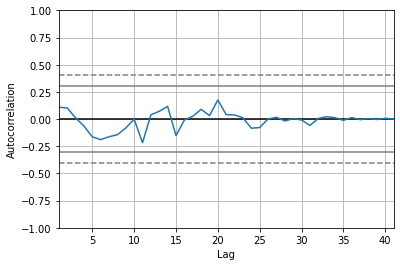

In [286]:
from pandas.plotting import autocorrelation_plot

autocorrelation_plot(forecast.PRCP)
plt.show()

In [287]:
# from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# fig = plot_acf(forecast['Seasonal First Difference'])
# fig.show()

In [288]:
# For non-seasonal data
#p=1, d=1, q=0 or 1
from statsmodels.tsa.arima_model import ARIMA

model=ARIMA(forecast.PRCP, order=(1,1,1))
model_fit=model.fit()
model_fit.summary()

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



<class 'statsmodels.iolib.summary.Summary'>
"""
                             ARIMA Model Results                              
==============================================================================
Dep. Variable:                 D.PRCP   No. Observations:                   40
Model:                 ARIMA(1, 1, 1)   Log Likelihood                -127.909
Method:                       css-mle   S.D. of innovations              5.673
Date:                Sat, 31 Jul 2021   AIC                            263.818
Time:                        20:41:37   BIC                            270.574
Sample:                    01-01-1982   HQIC                           266.261
                         - 01-01-2021                                         
================================================================================
                   coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------
const            0.0080      0.086      0.094      0.926      -0.160       0.176
ar.L1.D.PRCP     0.1353      0.159      0.850      0.401      -0.177       0.447
ma.L1.D.PRCP    -1.0000      0.072    -13.891      0.000      -1.141      -0.859
                                    Roots                                    
=============================================================================
                  Real          Imaginary           Modulus         Frequency
-----------------------------------------------------------------------------
AR.1            7.3891           +0.0000j            7.3891            0.0000
MA.1            1.0000           +0.0000j            1.0000            0.0000
-----------------------------------------------------------------------------
"""

In [289]:
import statsmodels.api as sm

model = sm.tsa.statespace.SARIMAX(forecast.PRCP, order=(5, 1, 0))
results = model.fit()

forecast['Forecast'] = results.predict(start = "2020-01-01", end = "2024-01-01", dynamic=True)
# forecast[['PRCP','Forecast']].plot(figsize=(12,8))

fig = go.Figure()
fig.add_trace(go.Scatter(x = forecast.index, y = forecast['PRCP'], name = "Recorded Precipitation", line=dict(color='blue', width=3, dash = "dashdot")))
fig.add_trace(go.Scatter(x = forecast.index, y = forecast['Forecast'], name = "Seasonal First Difference Precipitation Record", line=dict(color='red', width=3, dash = "dash")))
fig.update_xaxes(title_text = "YEAR", rangeslider_visible=True, showline=True, linewidth=2, linecolor='black', mirror=True)
fig.update_yaxes(title_text = "PRECIPIATION", showline=True, linewidth=2, linecolor='black', mirror=True)
fig.update_layout(height=500, width=1000, title='Malaysia Seasonal First Difference Precipitation Record')
fig.show()

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



In [290]:
prediction = pd.DataFrame(results.predict(start = "2020-01-01", end = "2024-01-01", dynamic=True))
prediction.rename(columns = {0:'Predicted PRCP'}, inplace = True)
prediction

,Predicted PRCP
2020-01-01,4.959579
2021-01-01,6.003809
2022-01-01,5.247138
2023-01-01,5.482032
2024-01-01,5.456602


In [291]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = forecast.index, y = forecast['PRCP'], mode='lines+markers', name = "Recorded Precipitation", line=dict(color='blue', width=2, dash = "dash")))
fig.add_trace(go.Scatter(x = prediction.index, y = prediction['Predicted PRCP'], name = "Predicted Precipitation", line=dict(color='red', width=2, dash = "dot")))
fig.update_xaxes(title_text = "YEAR", rangeslider_visible=True, showline=True, linewidth=2, linecolor='black', mirror=True)
fig.update_yaxes(title_text = "PRECIPIATION", showline=True, linewidth=2, linecolor='black', mirror=True)
fig.update_layout(height=500, width=1000, title='Malaysia Precipitation Prediction')
fig.show()

In [292]:
from pmdarima import auto_arima
stepwise_fit = auto_arima(forecast['PRCP'], trace=True, suppress_warnings=True)

Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.32 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=262.151, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=263.663, Time=0.03 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=263.742, Time=0.05 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=276.514, Time=0.01 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=265.499, Time=0.09 sec

Best model:  ARIMA(0,0,0)(0,0,0)[0] intercept
Total fit time: 0.524 seconds


## **ARIMA MODEL: Forecasting Temperature**

### Time Series Plot

In [312]:
train = cleandata[:int(cleandata.shape[0]*0.80)][["DATE", "TAVG"]]
test = cleandata[int(cleandata.shape[0]*0.80):][["DATE", "TAVG"]]

train.set_index(['DATE'])
test.set_index(['DATE'])

print("Training Data: ", train.shape, "Testing Data: ", test.shape)

Training Data:  (434, 2) Testing Data:  (109, 2)


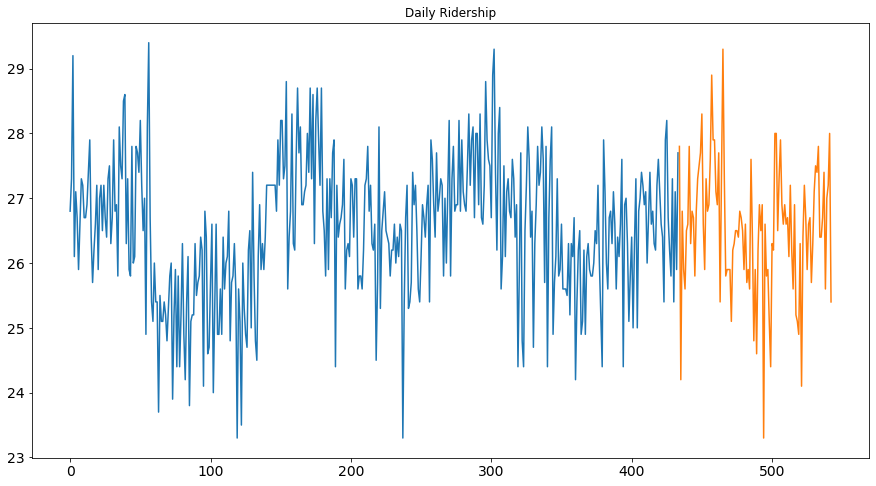

In [314]:
train.TAVG.plot(figsize=(15,8), title= 'Daily Ridership', fontsize=14)
test.TAVG.plot(figsize=(15,8), title= 'Daily Ridership', fontsize=14)
plt.show()

### ARIMA Forecasting

In [293]:
forecast = cleandata[['DATE', 'TAVG']].iloc[:41]
forecast.set_index('DATE',inplace=True)
forecast

,TAVG
DATE,
1981-01-01,26.8
1982-01-01,27.3
1983-01-01,29.2
1984-01-01,26.1
1985-01-01,27.1
1986-01-01,26.7
1987-01-01,25.9
1988-01-01,26.6
1989-01-01,27.3


In [294]:
forecast.describe()

,TAVG
count,41.000000
mean,26.982927
std,0.766127
min,25.700000
25%,26.500000
50%,26.900000
75%,27.300000
max,29.200000


In [295]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = forecast.index, y = forecast.TAVG, name = "Precipitation Record", line=dict(color='firebrick', width=4)))
fig.update_xaxes(title_text = "YEAR", rangeslider_visible=True, showline=True, linewidth=2, linecolor='black', mirror=True)
fig.update_yaxes(title_text = "TEMPERATURE", showline=True, linewidth=2, linecolor='black', mirror=True)
fig.update_layout(height=500, width=1000, title='Malaysia Precipitation Record')
fig.show()

In [296]:
### Testing For Stationarity
from statsmodels.tsa.stattools import adfuller

test_result = adfuller(forecast.TAVG)

#Ho: It is non stationary
#H1: It is stationary
def adfuller_test(prcp):
    result = adfuller(prcp)
    labels = ['ADF Test Statistic','p-value','#Lags Used','Number of Observations Used']
    for value, label in zip(result, labels):
        print(label+' : '+str(value) )
    if result[1] <= 0.05:
        print("strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data has no unit root and is stationary")
    else:
        print("weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary ")
      
adfuller_test(forecast.TAVG)

ADF Test Statistic : -5.734555744412422
p-value : 6.483445102314771e-07
#Lags Used : 0
Number of Observations Used : 40
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data has no unit root and is stationary


In [297]:
# forecast['TAVG First Difference'] = forecast['TAVG'] - forecast['TAVG'].shift(1)
# # forecast['TAVG'].shift(1)

# forecast['Seasonal First Difference'] = forecast['TAVG'] - forecast['TAVG'].shift(12)
# forecast.head(10)

In [298]:
# ## Again test dickey fuller test
# adfuller_test(forecast['Seasonal First Difference'].dropna())

In [299]:
# fig = px.line(forecast, x = forecast.index, y = forecast['Seasonal First Difference'])
# fig.add_trace(go.Scatter(x = forecast.index, y = forecast['Seasonal First Difference'], name = "Seasonal First Difference Precipitation Record", line=dict(color='firebrick', width=4)))
# fig.update_xaxes(title_text = "YEAR", rangeslider_visible=True, showline=True, linewidth=2, linecolor='black', mirror=True)
# fig.update_yaxes(title_text = "TEMPERATURE", showline=True, linewidth=2, linecolor='black', mirror=True)
# fig.update_layout(height=500, width=1000, title='Malaysia Seasonal First Difference Precipitation Record')
# fig.show()

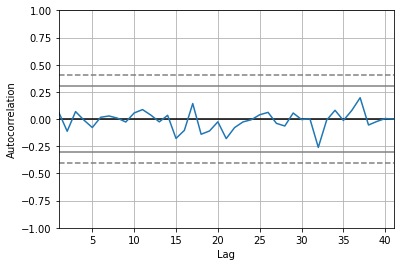

In [300]:
from pandas.plotting import autocorrelation_plot

autocorrelation_plot(forecast.TAVG)
plt.show()

In [301]:
# from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# fig = plot_acf(forecast['Seasonal First Difference'])
# fig.show()

In [302]:
# For non-seasonal data
#p=1, d=1, q=0 or 1
from statsmodels.tsa.arima_model import ARIMA

model = ARIMA(forecast.TAVG, order=(1,1,1))
model_fit = model.fit()

model_fit.summary()

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



<class 'statsmodels.iolib.summary.Summary'>
"""
                             ARIMA Model Results                              
==============================================================================
Dep. Variable:                 D.TAVG   No. Observations:                   40
Model:                 ARIMA(1, 1, 1)   Log Likelihood                 -47.434
Method:                       css-mle   S.D. of innovations              0.757
Date:                Sat, 31 Jul 2021   AIC                            102.867
Time:                        20:42:48   BIC                            109.623
Sample:                    01-01-1982   HQIC                           105.310
                         - 01-01-2021                                         
================================================================================
                   coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------
const            0.0094      0.011      0.884      0.382      -0.011       0.030
ar.L1.D.TAVG     0.0605      0.161      0.375      0.710      -0.256       0.377
ma.L1.D.TAVG    -0.9999      0.102     -9.830      0.000      -1.199      -0.801
                                    Roots                                    
=============================================================================
                  Real          Imaginary           Modulus         Frequency
-----------------------------------------------------------------------------
AR.1           16.5394           +0.0000j           16.5394            0.0000
MA.1            1.0001           +0.0000j            1.0001            0.0000
-----------------------------------------------------------------------------
"""

In [304]:
import statsmodels.api as sm

model = sm.tsa.statespace.SARIMAX(forecast.TAVG, order=(5, 1, 0))
results = model.fit()

forecast['Forecast'] = results.predict(start = "2020-01-01", end = "2024-01-01", dynamic=True)
# forecast[['PRCP','Forecast']].plot(figsize=(12,8))

fig = go.Figure()
fig.add_trace(go.Scatter(x = forecast.index, y = forecast['TAVG'], name = "Recorded Recipitation", line=dict(color='blue', width=3, dash = "dash")))
fig.add_trace(go.Scatter(x = forecast.index, y = forecast['Forecast'], name = "Seasonal First Difference Precipitation Record", line=dict(color='red', width=3, dash = "dot")))
fig.update_xaxes(title_text = "YEAR", rangeslider_visible=True, showline=True, linewidth=2, linecolor='black', mirror=True)
fig.update_yaxes(title_text = "TEMPERATURE", showline=True, linewidth=2, linecolor='black', mirror=True)
fig.update_layout(height=500, width=1000, title='Malaysia Seasonal First Difference Precipitation Record')
fig.show()

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



In [305]:
prediction = pd.DataFrame(results.predict(start = "2020-01-01", end = "2024-01-01", dynamic=True))
prediction.rename(columns = {0:'Predicted TAVG'}, inplace = True)
prediction

,Predicted TAVG
2020-01-01,27.518210
2021-01-01,27.075331
2022-01-01,27.832430
2023-01-01,27.720997
2024-01-01,27.447355


In [309]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = forecast.index, y = forecast['TAVG'], name = "Recorded Temperature", line=dict(color='blue', width=2)))
fig.add_trace(go.Scatter(x = prediction.index, y = prediction['Predicted TAVG'], name = "Predicted Temperature", line=dict(color='red', width=2)))
fig.update_xaxes(title_text = "YEAR", rangeslider_visible=True, showline=True, linewidth=2, linecolor='black', mirror=True)
fig.update_yaxes(title_text = "TEMPERATURE", showline=True, linewidth=2, linecolor='black', mirror=True)
fig.update_layout(height=500, width=1000, title='Malaysia Precipitation Prediction')
fig.show()

In [311]:
from pmdarima import auto_arima
stepwise_fit = auto_arima(forecast['TAVG'], trace=True, suppress_warnings=True)

Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=104.530, Time=0.31 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=97.495, Time=0.04 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=99.340, Time=0.04 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=99.289, Time=0.03 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=388.592, Time=0.01 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=101.262, Time=0.22 sec

Best model:  ARIMA(0,0,0)(0,0,0)[0] intercept
Total fit time: 0.667 seconds
